In [1]:
!pip install shap
!pip install deepchecks alibi alibi[tensorflow]

In [2]:
import warnings
import numpy as np
import pandas as pd
pd.set_option('max_colwidth', 600)
import seaborn as sns
sns.set(style='darkgrid', font_scale=1.6)
import matplotlib.pyplot as plt
plt.style.use('seaborn')
%matplotlib inline
pd.set_option('display.max_columns',None)

<ipython-input-2-61e21a9f204d>:8: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [3]:
warnings.filterwarnings('ignore')
import os
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
cd "/content/drive/My Drive/Explainable AI Libraries"

/content/drive/My Drive/Explainable AI Libraries


In [6]:
ls

 Credit_Risk_Dataset.xlsx  'Credit RISK - Explainable AI Libraries project.ipynb'   xgb_model.pkl


In [7]:
data = pd.read_excel('Credit_Risk_Dataset.xlsx')

In [8]:
data.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years)
0,7013527,Consolidation,55884.0,11.84,6
1,7014291,Consolidation,55511.0,16.94,4
2,7014327,Consolidation,12289.0,11.84,6
3,7014304,Credit Card,29324.0,14.71,4
4,7031995,Credit Card,30252.0,14.71,4


In [9]:
path = "/content/drive/My Drive/Explainable AI Libraries/Credit_Risk_Dataset.xlsx"
sheet_names = ['loan_information', 'Employment', 'Personal_information', 'Other_information']
def read_excel_data(path,sheet_names):
  data_frames= []
  for name_of_the_sheet in sheet_names :
    df = pd.read_excel(path, sheet_name=name_of_the_sheet, engine='openpyxl')
    data_frames.append(df)
  return data_frames

In [10]:
all_dfs = read_excel_data(path, sheet_names)

In [11]:
len(all_dfs)

4

In [12]:
loan_information = all_dfs[0]
employment = all_dfs[1]
personal_information = all_dfs[2]
other_information = all_dfs[3]

In [13]:
loan_information.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years)
0,7013527,Consolidation,55884.0,11.84,6
1,7014291,Consolidation,55511.0,16.94,4
2,7014327,Consolidation,12289.0,11.84,6
3,7014304,Credit Card,29324.0,14.71,4
4,7031995,Credit Card,30252.0,14.71,4


In [14]:
loan_information.shape

(134417, 5)

In [15]:
employment.head()

,User id,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA)
0,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIUGp9a+9oBSLvyI5Jdz9fNg=,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0
1,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIasttBX92VTWzdldgDGNrI4=,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0
2,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhYq8O0ygAy1wZSaxqrNLNYfOibgdA1QeQhNPkLJcwKVc=,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0
3,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhU4gDxq3nasE2lBvkF3BByiHO4FJWtkam4oglyfSc5To=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0
4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhd9MxBQLjUjv++jfpgYoMqnBasBZFnH48Gq5+cHbJ+zg=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0


In [16]:
employment.shape

(134417, 7)

In [17]:
personal_information.head()

,User id,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified
0,7013527,Female,Yes,4,rent,XX852X,No,NaN
1,7014291,Female,No,1,mortgage,XX286X,NaN,Source Verified
2,7014327,Other,NaN,3,own,XX113X,No,NaN
3,7014304,Male,NaN,1,rent,XX941X,Yes,NaN
4,7031995,Male,NaN,3,rent,XX913X,No,Verified


In [18]:
personal_information.shape

(134417, 8)

In [19]:
other_information.head()

,User_id,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,0,1824.150000,971.46,852.69,0,1
1,7014291,0,22912.532998,18000.00,4912.53,0,0
2,7014327,0,7800.440000,4489.76,3310.68,0,1
3,7014304,0,6672.050000,5212.29,1459.76,0,0
4,7031995,0,11793.001345,10000.00,1793.00,0,0


In [20]:
other_information.shape

(134417, 7)

In [21]:
# Merging all sheets

merged_df = pd.merge(loan_information, employment, left_on='User_id',right_on='User id')
merged_df = pd.merge(merged_df, personal_information, left_on='User_id',right_on='User id')
merged_df = pd.merge(merged_df, other_information, left_on='User_id',right_on='User_id')

In [22]:
merged_df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA),User id_y,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIUGp9a+9oBSLvyI5Jdz9fNg=,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0,7013527,Female,Yes,4,rent,XX852X,No,NaN,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIasttBX92VTWzdldgDGNrI4=,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0,7014291,Female,No,1,mortgage,XX286X,NaN,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhYq8O0ygAy1wZSaxqrNLNYfOibgdA1QeQhNPkLJcwKVc=,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0,7014327,Other,NaN,3,own,XX113X,No,NaN,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhU4gDxq3nasE2lBvkF3BByiHO4FJWtkam4oglyfSc5To=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0,7014304,Male,NaN,1,rent,XX941X,Yes,NaN,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhd9MxBQLjUjv++jfpgYoMqnBasBZFnH48Gq5+cHbJ+zg=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0,7031995,Male,NaN,3,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0


In [23]:
merged_df.shape

(143727, 26)

In [24]:
df = merged_df.copy()

# **EDA (Exploratory Data Analysis)**

In [25]:
df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA),User id_y,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIUGp9a+9oBSLvyI5Jdz9fNg=,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0,7013527,Female,Yes,4,rent,XX852X,No,NaN,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIasttBX92VTWzdldgDGNrI4=,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0,7014291,Female,No,1,mortgage,XX286X,NaN,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhYq8O0ygAy1wZSaxqrNLNYfOibgdA1QeQhNPkLJcwKVc=,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0,7014327,Other,NaN,3,own,XX113X,No,NaN,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhU4gDxq3nasE2lBvkF3BByiHO4FJWtkam4oglyfSc5To=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0,7014304,Male,NaN,1,rent,XX941X,Yes,NaN,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhd9MxBQLjUjv++jfpgYoMqnBasBZFnH48Gq5+cHbJ+zg=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0,7031995,Male,NaN,3,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0


In [26]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 143727 entries, 0 to 143726
Data columns (total 26 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   User_id             143727 non-null  int64  
 1   Loan Category       143727 non-null  object 
 2   Amount              111803 non-null  float64
 3   Interest Rate       143727 non-null  float64
 4   Tenure(years)       143727 non-null  int64  
 5   User id_x           143727 non-null  int64  
 6   Employmet type      59085 non-null   object 
 7   Tier of Employment  59085 non-null   object 
 8   Industry            143723 non-null  object 
 9   Role                143727 non-null  object 
 10  Work Experience     143723 non-null  object 
 11  Total Income(PA)    143727 non-null  float64
 12  User id_y           143727 non-null  int64  
 13  Gender              143727 non-null  object 
 14  Married             95584 non-null   object 
 15  Dependents          143727 non-nul

In [27]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
User_id,143727.0,3.733474e+07,3.182811e+07,208036.00,3276118.000,57665174.00,6.729174e+07,7.895894e+07
Amount,111803.0,1.376458e+05,1.575427e+05,0.00,28379.500,76603.00,2.054645e+05,8.000078e+06
Interest Rate,143727.0,1.203870e+01,3.880204e+00,5.42,9.180,11.84,1.444000e+01,2.354000e+01
Tenure(years),143727.0,4.514503e+00,8.742415e-01,4.00,4.000,4.00,6.000000e+00,6.000000e+00
User id_x,143727.0,3.733474e+07,3.182811e+07,208036.00,3276118.000,57665174.00,6.729174e+07,7.895894e+07
Total Income(PA),143727.0,7.242256e+04,5.539328e+04,4000.00,45000.000,61800.00,8.600000e+04,7.141778e+06
User id_y,143727.0,3.733474e+07,3.182811e+07,208036.00,3276118.000,57665174.00,6.729174e+07,7.895894e+07
Dependents,143727.0,1.997113e+00,1.411317e+00,0.00,1.000,2.00,3.000000e+00,4.000000e+00
Delinq_2yrs,143727.0,2.766008e-01,7.890189e-01,0.00,0.000,0.00,0.000000e+00,2.200000e+01
Total Payement,143727.0,1.084088e+04,8.613422e+03,0.00,4674.775,8212.41,1.417577e+04,5.777758e+04


In [28]:
df.describe(include='object').T

,count,unique,top,freq
Loan Category,143727,7,Consolidation,86363
Employmet type,59085,2,Salaried,47890
Tier of Employment,59085,7,B,18388
Industry,143723,12974,0,120614
Role,143727,46,KHMbckjadbckIFGCASEWdkcndwkcnCCM,22476
Work Experience,143723,7,0,120614
Gender,143727,3,Female,48083
Married,95584,2,Yes,47833
Home,143727,5,mortgage,69900
Pincode,143727,844,XX945X,1677


In [29]:
df.isnull().sum()

## .. here we can see that 'Employmet type' & 'Tier of Employment' have highest null values

User_id                   0
Loan Category             0
Amount                31924
Interest Rate             0
Tenure(years)             0
User id_x                 0
Employmet type        84642
Tier of Employment    84642
Industry                  4
Role                      0
Work Experience           4
Total Income(PA)          0
User id_y                 0
Gender                    0
Married               48143
Dependents                0
Home                      0
Pincode                   0
Social Profile        47856
Is_verified           35803
Delinq_2yrs               0
Total Payement            0
Received Principal        0
Interest Received         0
Number of loans           0
Defaulter                 0
dtype: int64

In [30]:
df.isnull().mean().sort_values(ascending=False)

## this command gives the percentage wise null value count for eaxch column

Employmet type        0.588908
Tier of Employment    0.588908
Married               0.334961
Social Profile        0.332965
Is_verified           0.249104
Amount                0.222116
Industry              0.000028
Work Experience       0.000028
User_id               0.000000
Home                  0.000000
Number of loans       0.000000
Interest Received     0.000000
Received Principal    0.000000
Total Payement        0.000000
Delinq_2yrs           0.000000
Pincode               0.000000
Gender                0.000000
Dependents            0.000000
Loan Category         0.000000
User id_y             0.000000
Total Income(PA)      0.000000
Role                  0.000000
User id_x             0.000000
Tenure(years)         0.000000
Interest Rate         0.000000
Defaulter             0.000000
dtype: float64

* **Industry, Work experience : drop missing values**
* **Married, Social Profile, Is_verified : create new category for null values**
* **Amount : Will evaluate its impact later and then decide**
* **Employmet type & Tier of Employment : approach will decide later**


In [31]:
df.dropna(subset=['Industry','Work Experience'],inplace=True)

In [32]:
df.isnull().sum()

User_id                   0
Loan Category             0
Amount                31923
Interest Rate             0
Tenure(years)             0
User id_x                 0
Employmet type        84639
Tier of Employment    84639
Industry                  0
Role                      0
Work Experience           0
Total Income(PA)          0
User id_y                 0
Gender                    0
Married               48142
Dependents                0
Home                      0
Pincode                   0
Social Profile        47855
Is_verified           35801
Delinq_2yrs               0
Total Payement            0
Received Principal        0
Interest Received         0
Number of loans           0
Defaulter                 0
dtype: int64

In [33]:
# Creating new category for null values with a function .
##--- for my understanding : creating new category for null values via function for these columns-->Married, Social Profile, Is_verified

def replace_null_values_with_a_value(df, columns, value):
  for column in columns:
    df[column]=df[column].fillna(value)
  return df

In [34]:
df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA),User id_y,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIUGp9a+9oBSLvyI5Jdz9fNg=,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0,7013527,Female,Yes,4,rent,XX852X,No,NaN,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIasttBX92VTWzdldgDGNrI4=,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0,7014291,Female,No,1,mortgage,XX286X,NaN,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhYq8O0ygAy1wZSaxqrNLNYfOibgdA1QeQhNPkLJcwKVc=,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0,7014327,Other,NaN,3,own,XX113X,No,NaN,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhU4gDxq3nasE2lBvkF3BByiHO4FJWtkam4oglyfSc5To=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0,7014304,Male,NaN,1,rent,XX941X,Yes,NaN,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhd9MxBQLjUjv++jfpgYoMqnBasBZFnH48Gq5+cHbJ+zg=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0,7031995,Male,NaN,3,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0


In [35]:
df['Tier of Employment'].unique()

array(['B', 'D', nan, 'C', 'A', 'E', 'G', 'F'], dtype=object)

In [36]:
## calling the function to replace null values with 'missing'

replace_with = 'missing'
columns_to_replace = ['Employmet type','Married','Social Profile','Is_verified']
df = replace_null_values_with_a_value(df, columns_to_replace, replace_with)

In [37]:
df.isnull().sum()

User_id                   0
Loan Category             0
Amount                31923
Interest Rate             0
Tenure(years)             0
User id_x                 0
Employmet type            0
Tier of Employment    84639
Industry                  0
Role                      0
Work Experience           0
Total Income(PA)          0
User id_y                 0
Gender                    0
Married                   0
Dependents                0
Home                      0
Pincode                   0
Social Profile            0
Is_verified               0
Delinq_2yrs               0
Total Payement            0
Received Principal        0
Interest Received         0
Number of loans           0
Defaulter                 0
dtype: int64

In [38]:
df.Amount.head(30)

0      55884.0
1      55511.0
2      12289.0
3      29324.0
4      30252.0
5     335322.0
6     263518.0
7      80359.0
8      19504.0
9     306031.0
10     15538.0
11    123670.0
12     33787.0
13    269815.0
14    127507.0
15    158538.0
16     29165.0
17    104639.0
18     77065.0
19    689387.0
20     33107.0
21    143303.0
22    157996.0
23     12604.0
24    121368.0
25    183716.0
26    145626.0
27      6349.0
28    632409.0
29     25371.0
Name: Amount, dtype: float64

In [39]:
# Creating a new column to indicate the missing amount

df['amount_missing'] = np.where(df['Amount'].isnull(),0,1) #if amount present i.e., it will fill with '1', if not '0'

## replacing null values in 'Amount' coulmn with -1000 to differentiate with rest of the data
replace_with = -1000
columns_to_replace = ['Amount']
df = replace_null_values_with_a_value(df, columns_to_replace, replace_with)

In [40]:
df.isnull().sum()

User_id                   0
Loan Category             0
Amount                    0
Interest Rate             0
Tenure(years)             0
User id_x                 0
Employmet type            0
Tier of Employment    84639
Industry                  0
Role                      0
Work Experience           0
Total Income(PA)          0
User id_y                 0
Gender                    0
Married                   0
Dependents                0
Home                      0
Pincode                   0
Social Profile            0
Is_verified               0
Delinq_2yrs               0
Total Payement            0
Received Principal        0
Interest Received         0
Number of loans           0
Defaulter                 0
amount_missing            0
dtype: int64

In [41]:
df['Tier of Employment'].unique()

array(['B', 'D', nan, 'C', 'A', 'E', 'G', 'F'], dtype=object)

In [42]:
## replacing null values in 'Tier of Employment ' coulmn with 'Z' to differentiate with rest of the data
replace_with = 'Z'
columns_to_replace = ['Tier of Employment']
df = replace_null_values_with_a_value(df, columns_to_replace, replace_with)

In [43]:
df.isnull().sum()

User_id               0
Loan Category         0
Amount                0
Interest Rate         0
Tenure(years)         0
User id_x             0
Employmet type        0
Tier of Employment    0
Industry              0
Role                  0
Work Experience       0
Total Income(PA)      0
User id_y             0
Gender                0
Married               0
Dependents            0
Home                  0
Pincode               0
Social Profile        0
Is_verified           0
Delinq_2yrs           0
Total Payement        0
Received Principal    0
Interest Received     0
Number of loans       0
Defaulter             0
amount_missing        0
dtype: int64

In [44]:
df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,Work Experience,Total Income(PA),User id_y,Gender,Married,Dependents,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIUGp9a+9oBSLvyI5Jdz9fNg=,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,1-2,125000.0,7013527,Female,Yes,4,rent,XX852X,No,missing,0,1824.150000,971.46,852.69,0,1,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhmLVIVxoGY7TUDJ1FyFoSIasttBX92VTWzdldgDGNrI4=,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,10+,61000.0,7014291,Female,No,1,mortgage,XX286X,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0,1
2,7014327,Consolidation,12289.0,11.84,6,7014327,missing,Z,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhYq8O0ygAy1wZSaxqrNLNYfOibgdA1QeQhNPkLJcwKVc=,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,5-10,100000.0,7014327,Other,missing,3,own,XX113X,No,missing,0,7800.440000,4489.76,3310.68,0,1,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,missing,Z,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhU4gDxq3nasE2lBvkF3BByiHO4FJWtkam4oglyfSc5To=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,2-3,30000.0,7014304,Male,missing,1,rent,XX941X,Yes,missing,0,6672.050000,5212.29,1459.76,0,0,1
4,7031995,Credit Card,30252.0,14.71,4,7031995,missing,Z,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtUhXGgZjtNQMnUXIWhIhd9MxBQLjUjv++jfpgYoMqnBasBZFnH48Gq5+cHbJ+zg=,KHMbckjadbckIFGCASEWdkcndwkcnCCM,10+,65000.0,7031995,Male,missing,3,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0,1


In [45]:
# checking unique values for a particular column

df['Loan Category'].unique()


array(['Consolidation', 'Credit Card', 'Home', 'Other ', 'Business',
       'Car ', 'Medical '], dtype=object)

In [46]:
df['Loan Category'].nunique()  # Checking number of unique values for a particular column

7

In [47]:
# Dropping categorical columns as they are too many..

def unique_values_in_each_column(df):
  for column in df.columns:
    print(column,':',df[column].nunique())
unique_values_in_each_column(df)

User_id : 133748
Loan Category : 7
Amount : 86157
Interest Rate : 137
Tenure(years) : 2
User id_x : 133748
Employmet type : 3
Tier of Employment : 8
Industry : 12974
Role : 46
Work Experience : 7
Total Income(PA) : 11380
User id_y : 133748
Gender : 3
Married : 3
Dependents : 5
Home : 5
Pincode : 844
Social Profile : 3
Is_verified : 4
Delinq_2yrs : 22
Total Payement  : 104199
Received Principal : 42021
Interest Received : 93859
Number of loans : 5
Defaulter : 2
amount_missing : 2


In [48]:
# Columns to drop

columns_to_drop =['User_id', 'User id_x','Industry', 'Role', 'User id_y', 'Pincode' ]
df.drop(columns_to_drop,axis=1,inplace=True)
df.head()

,Loan Category,Amount,Interest Rate,Tenure(years),Employmet type,Tier of Employment,Work Experience,Total Income(PA),Gender,Married,Dependents,Home,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing
0,Consolidation,55884.0,11.84,6,Salaried,B,1-2,125000.0,Female,Yes,4,rent,No,missing,0,1824.150000,971.46,852.69,0,1,1
1,Consolidation,55511.0,16.94,4,Self - Employeed,D,10+,61000.0,Female,No,1,mortgage,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0,1
2,Consolidation,12289.0,11.84,6,missing,Z,5-10,100000.0,Other,missing,3,own,No,missing,0,7800.440000,4489.76,3310.68,0,1,1
3,Credit Card,29324.0,14.71,4,missing,Z,2-3,30000.0,Male,missing,1,rent,Yes,missing,0,6672.050000,5212.29,1459.76,0,0,1
4,Credit Card,30252.0,14.71,4,missing,Z,10+,65000.0,Male,missing,3,rent,No,Verified,0,11793.001345,10000.00,1793.00,0,0,1


In [50]:
# # Checking multi-collinearity
# ## Correlation methods : Pearson, Kendall, Spearman

# def correlation_heatmap(df):
#   correlations = df.corr()
#   fig,ax=plt.subplots(figsize=(14,14))
#   sns.heatmap(correlations,annot=True,square=True,center=0,linewidth=0.5,cbar_kws={'shrink':0.4},vmax=1,fmt='.2f'
#   )
#   plt.show()

# correlation_heatmap(df)

* **Since no two variables have high correlation with each other , it is good to use all the features/columns/variables/dimensions for model building.**

In [49]:
# Univariate Analysis

import plotly.express as px

def feature_distributions(df):
  for column in df.columns:
    fig = px.histogram(df,x=column,hover_data=df.columns)
    fig.show()

feature_distributions(df)

* Observations : Write observations of the above...

In [51]:
df.head()

,Loan Category,Amount,Interest Rate,Tenure(years),Employmet type,Tier of Employment,Work Experience,Total Income(PA),Gender,Married,Dependents,Home,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing
0,Consolidation,55884.0,11.84,6,Salaried,B,1-2,125000.0,Female,Yes,4,rent,No,missing,0,1824.150000,971.46,852.69,0,1,1
1,Consolidation,55511.0,16.94,4,Self - Employeed,D,10+,61000.0,Female,No,1,mortgage,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0,1
2,Consolidation,12289.0,11.84,6,missing,Z,5-10,100000.0,Other,missing,3,own,No,missing,0,7800.440000,4489.76,3310.68,0,1,1
3,Credit Card,29324.0,14.71,4,missing,Z,2-3,30000.0,Male,missing,1,rent,Yes,missing,0,6672.050000,5212.29,1459.76,0,0,1
4,Credit Card,30252.0,14.71,4,missing,Z,10+,65000.0,Male,missing,3,rent,No,Verified,0,11793.001345,10000.00,1793.00,0,0,1


In [52]:
def unique_values(df):
  for column in df.columns:
    print(column,':',df[column].unique())
    print('#'*80)
unique_values(df)

Loan Category : ['Consolidation' 'Credit Card' 'Home' 'Other ' 'Business' 'Car '
 'Medical ']
################################################################################
Amount : [ 55884.  55511.  12289. ... 287564. 186923. 181161.]
################################################################################
Interest Rate : [11.84 16.94 14.71 10.95 10.06 16.7  12.94  9.18 12.73 13.83 15.6   6.88
 16.05 14.27  5.98  8.04  5.45 20.3  19.85 22.48 17.21 18.97  7.14 21.52
 21.03 18.51 19.41 17.81 21.46 21.34 20.73 22.43  5.42 22.31 14.28 13.23
 16.48  9.7  16.75 12.35  8.82 12.64 19.84 18.96 16.25 18.52 20.28 17.36
 21.98 20.58 19.4  21.07 18.06 21.86 22.36 21.01 20.89 22.15 17.54 11.22
  8.95  6.78 20.54 11.46 19.57 13.79 12.18 18.34 18.87 14.42 15.88 10.58
 17.98  9.62 17.19 15.15 12.89 19.22 21.24 16.84 20.19 21.6  19.93 12.9
 21.78 11.19  6.31 12.34 15.48 14.08 10.83 10.33 19.86 12.93  9.47 14.44
 13.54  8.57 11.73 16.13 14.89  6.77  7.4  20.77  7.83 17.38 23.33  5.86
 21.67 23

In [53]:
## Performing ONE HOT ENCODING for coulmns that have no order

categorical_features_for_OHE = ['Loan Category', 'Employmet type', 'Gender', 'Married', 'Home', 'Social Profile', 'Is_verified']
df = pd.get_dummies(df,columns=categorical_features_for_OHE)
df.head()

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing,Loan Category_Business,Loan Category_Car,Loan Category_Consolidation,Loan Category_Credit Card,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Gender_Female,Gender_Male,Gender_Other,Married_No,Married_Yes,Married_missing,Home_mortgage,Home_none,Home_other,Home_own,Home_rent,Social Profile_No,Social Profile_Yes,Social Profile_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.0,11.84,6,B,1-2,125000.0,4,0,1824.150000,971.46,852.69,0,1,1,False,False,True,False,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,False,True,True,False,False,False,False,False,True
1,55511.0,16.94,4,D,10+,61000.0,1,0,22912.532998,18000.00,4912.53,0,0,1,False,False,True,False,False,False,False,False,True,False,True,False,False,True,False,False,True,False,False,False,False,False,False,True,False,True,False,False
2,12289.0,11.84,6,Z,5-10,100000.0,3,0,7800.440000,4489.76,3310.68,0,1,1,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,True
3,29324.0,14.71,4,Z,2-3,30000.0,1,0,6672.050000,5212.29,1459.76,0,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,True
4,30252.0,14.71,4,Z,10+,65000.0,3,0,11793.001345,10000.00,1793.00,0,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,True,False,False,False,False,True,False


In [54]:
## Performing Ordinal Encoding

from sklearn.preprocessing import OrdinalEncoder

categorical_features_for_OE = ['Tier of Employment', 'Work Experience' ]
def performing_OE(df,ordinal_features,custom_mapping):
  encoder = OrdinalEncoder(categories=custom_mapping)
  df[ordinal_features]=encoder.fit_transform(df[ordinal_features])
  return df

# Creating custom mapping for categories

tier_of_employment_order = list(df['Tier of Employment'].unique())
tier_of_employment_order.sort()

# Creating Work Experience order

work_experience_order =  [0,'<1', '1-2', '2-3', '3-5', '5-10', '10+']

custom_mapping = [tier_of_employment_order,work_experience_order]
df = performing_OE(df,categorical_features_for_OE,custom_mapping)

In [55]:
df.head()

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing,Loan Category_Business,Loan Category_Car,Loan Category_Consolidation,Loan Category_Credit Card,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Gender_Female,Gender_Male,Gender_Other,Married_No,Married_Yes,Married_missing,Home_mortgage,Home_none,Home_other,Home_own,Home_rent,Social Profile_No,Social Profile_Yes,Social Profile_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.0,11.84,6,1.0,2.0,125000.0,4,0,1824.150000,971.46,852.69,0,1,1,False,False,True,False,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,False,True,True,False,False,False,False,False,True
1,55511.0,16.94,4,3.0,6.0,61000.0,1,0,22912.532998,18000.00,4912.53,0,0,1,False,False,True,False,False,False,False,False,True,False,True,False,False,True,False,False,True,False,False,False,False,False,False,True,False,True,False,False
2,12289.0,11.84,6,7.0,5.0,100000.0,3,0,7800.440000,4489.76,3310.68,0,1,1,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,True
3,29324.0,14.71,4,7.0,3.0,30000.0,1,0,6672.050000,5212.29,1459.76,0,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,True
4,30252.0,14.71,4,7.0,6.0,65000.0,3,0,11793.001345,10000.00,1793.00,0,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,True,False,False,False,False,True,False


In [56]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 143723 entries, 0 to 143726
Data columns (total 42 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   Amount                           143723 non-null  float64
 1   Interest Rate                    143723 non-null  float64
 2   Tenure(years)                    143723 non-null  int64  
 3   Tier of Employment               143723 non-null  float64
 4   Work Experience                  143723 non-null  float64
 5   Total Income(PA)                 143723 non-null  float64
 6   Dependents                       143723 non-null  int64  
 7   Delinq_2yrs                      143723 non-null  int64  
 8   Total Payement                   143723 non-null  float64
 9   Received Principal               143723 non-null  float64
 10  Interest Received                143723 non-null  float64
 11  Number of loans                  143723 non-null  int64  
 12  Default

In [57]:
target_column = df['Defaulter']
target_column.head()

0    1
1    0
2    1
3    0
4    0
Name: Defaulter, dtype: int64

In [58]:
## moving the target column to the last position i.e. to the last coulmn...

columns = list(df.columns)
columns.append(columns.pop(columns.index('Defaulter')))
df = df[columns]

In [59]:
columns

['Amount',
 'Interest Rate',
 'Tenure(years)',
 'Tier of Employment',
 'Work Experience',
 'Total Income(PA)',
 'Dependents',
 'Delinq_2yrs',
 'Total Payement ',
 'Received Principal',
 'Interest Received',
 'Number of loans',
 'amount_missing',
 'Loan Category_Business',
 'Loan Category_Car ',
 'Loan Category_Consolidation',
 'Loan Category_Credit Card',
 'Loan Category_Home',
 'Loan Category_Medical ',
 'Loan Category_Other ',
 'Employmet type_Salaried',
 'Employmet type_Self - Employeed',
 'Employmet type_missing',
 'Gender_Female',
 'Gender_Male',
 'Gender_Other',
 'Married_No',
 'Married_Yes',
 'Married_missing',
 'Home_mortgage',
 'Home_none',
 'Home_other',
 'Home_own',
 'Home_rent',
 'Social Profile_No',
 'Social Profile_Yes',
 'Social Profile_missing',
 'Is_verified_Not Verified',
 'Is_verified_Source Verified',
 'Is_verified_Verified',
 'Is_verified_missing',
 'Defaulter']

In [60]:
# df.drop(['Defaulter'],axis=1, inplace=True)

In [61]:
df.head()

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,amount_missing,Loan Category_Business,Loan Category_Car,Loan Category_Consolidation,Loan Category_Credit Card,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Gender_Female,Gender_Male,Gender_Other,Married_No,Married_Yes,Married_missing,Home_mortgage,Home_none,Home_other,Home_own,Home_rent,Social Profile_No,Social Profile_Yes,Social Profile_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing,Defaulter
0,55884.0,11.84,6,1.0,2.0,125000.0,4,0,1824.150000,971.46,852.69,0,1,False,False,True,False,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,False,True,True,False,False,False,False,False,True,1
1,55511.0,16.94,4,3.0,6.0,61000.0,1,0,22912.532998,18000.00,4912.53,0,1,False,False,True,False,False,False,False,False,True,False,True,False,False,True,False,False,True,False,False,False,False,False,False,True,False,True,False,False,0
2,12289.0,11.84,6,7.0,5.0,100000.0,3,0,7800.440000,4489.76,3310.68,0,1,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,True,1
3,29324.0,14.71,4,7.0,3.0,30000.0,1,0,6672.050000,5212.29,1459.76,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,True,0
4,30252.0,14.71,4,7.0,6.0,65000.0,3,0,11793.001345,10000.00,1793.00,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,True,False,False,False,False,True,False,0


In [62]:
df.Defaulter.value_counts()

Defaulter
0    130254
1     13469
Name: count, dtype: int64

# **Class Balancing using Adaptive Synthetic Sampling (ADASYN)**

In [63]:
from imblearn.over_sampling import ADASYN

def fixing_class_imbalance(df,target_column):
  X = df.drop(target_column,axis=1)
  y = df[target_column]

  adasyn = ADASYN(random_state=50)
  X_resampled,y_resampled = adasyn.fit_resample(X,y)
  return X_resampled,y_resampled

In [64]:
# Applying ADASYN

target_column = 'Defaulter'
X_resampled,y_resampled = fixing_class_imbalance(df,target_column)

In [65]:
X_resampled

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,amount_missing,Loan Category_Business,Loan Category_Car,Loan Category_Consolidation,Loan Category_Credit Card,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Gender_Female,Gender_Male,Gender_Other,Married_No,Married_Yes,Married_missing,Home_mortgage,Home_none,Home_other,Home_own,Home_rent,Social Profile_No,Social Profile_Yes,Social Profile_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,55884.000000,11.840000,6,1.000000,2.0,125000.0,4,0,1824.150000,971.460000,852.690000,0,1,False,False,True,False,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,False,True,True,False,False,False,False,False,True
1,55511.000000,16.940000,4,3.000000,6.0,61000.0,1,0,22912.532998,18000.000000,4912.530000,0,1,False,False,True,False,False,False,False,False,True,False,True,False,False,True,False,False,True,False,False,False,False,False,False,True,False,True,False,False
2,12289.000000,11.840000,6,7.000000,5.0,100000.0,3,0,7800.440000,4489.760000,3310.680000,0,1,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,True
3,29324.000000,14.710000,4,7.000000,3.0,30000.0,1,0,6672.050000,5212.290000,1459.760000,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,True
4,30252.000000,14.710000,4,7.000000,6.0,65000.0,3,0,11793.001345,10000.000000,1793.000000,0,1,False,False,False,True,False,False,False,False,False,True,False,True,False,False,False,True,False,False,False,False,True,True,False,False,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
262702,14370.591919,12.878047,5,7.000000,0.0,60000.0,2,0,2279.452236,397.121139,274.845263,0,1,False,False,True,False,False,False,False,False,False,True,True,False,True,True,True,False,False,False,False,False,True,True,False,False,True,False,True,False
262703,15431.908523,12.322682,4,6.671335,0.0,60000.0,1,0,2080.050952,1433.402942,646.648010,0,1,False,False,True,False,False,True,False,False,True,True,False,False,True,True,False,False,True,False,False,False,True,True,True,False,True,False,False,True
262704,14283.023752,13.128341,5,7.000000,0.0,60000.0,2,0,2356.250144,343.212983,269.073252,0,1,False,False,True,False,False,False,False,False,False,True,True,False,True,True,True,False,False,False,False,False,True,True,False,False,True,False,True,False
262705,14380.953086,12.848432,5,7.000000,0.0,60000.0,2,0,2270.365419,403.499615,275.528214,0,1,False,False,True,False,False,False,False,False,False,True,True,False,True,True,True,False,False,False,False,False,True,True,False,False,True,False,True,False


In [66]:
y_resampled.value_counts()

Defaulter
1    132453
0    130254
Name: count, dtype: int64

In [69]:
from imblearn.over_sampling import RandomOverSampler

def fix_imbalance_using_oversampling(dataframe, target_column):

  # Separating the features and the target variable
  X = dataframe.drop(target_column, axis =1)
  y = dataframe[target_column]

  # Applying ROS using randomoversampler
  oversampler = RandomOverSampler(random_state = 50) # random seed
  X, y = oversampler.fit_resample(X, y)

  return X, y

In [71]:
# Applying ROS

target_column = 'Defaulter'

X, y = fix_imbalance_using_oversampling(df, target_column)

# **Model development & evaluation**

 ## **Train_test Split**

In [72]:
from sklearn.model_selection import train_test_split

train_x, test_x, train_y, test_y = train_test_split(X, y, test_size = 0.2, random_state = 50)

In [74]:
!pip install neptune

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 502.0/502.0 kB 6.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 15.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.2/12.2 MB 40.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.2/82.2 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.9/63.9 kB 6.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.9/137.9 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 2.8 MB/s eta 0:00:00
  Created wheel for bravado-core: filename=bravado_core-6.1.1-py2.py3-none-any.whl size=67672 sha256=2720c0b09ec8581c0c89cde798de72112e9906545cc52728ed0cbc35eda1453b
  Stored in directory: /root/.cache/pip/wheels/42/35/4a/44ec4c358db21a5d63ed4e40f0f0012a438106f220bce4ccba
Successfully built bravado-core


In [75]:
!pip install neptune-xgboost

In [76]:
# Importing necessary libraries for modeling

from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import GridSearchCV
import time
import xgboost as xgb

import neptune
from hyperopt import fmin, tpe, hp, STATUS_OK
from hyperopt.pyll import scope
from neptune.integrations.xgboost import NeptuneCallback

import pickle
from sklearn.metrics import classification_report, confusion_matrix

In [77]:
xgb_model = xgb.XGBClassifier()

xgb_model.fit(train_x, train_y) # Training our model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...)

In [78]:
from sklearn.metrics import accuracy_score

predictions = xgb_model.predict(test_x) # Getting model predictions

accuracy = accuracy_score(test_y, predictions) # Checking the model accuracy
print("Accuracy SCore:", accuracy)

Accuracy SCore: 0.9628229242639438


In [79]:
test_x

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,amount_missing,Loan Category_Business,Loan Category_Car,Loan Category_Consolidation,Loan Category_Credit Card,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Gender_Female,Gender_Male,Gender_Other,Married_No,Married_Yes,Married_missing,Home_mortgage,Home_none,Home_other,Home_own,Home_rent,Social Profile_No,Social Profile_Yes,Social Profile_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
213479,150567.0,11.84,4,1.0,2.0,62000.0,3,0,12411.88,9381.09,3003.79,0,1,False,False,True,False,False,False,False,True,False,False,False,True,False,False,True,False,True,False,False,False,False,False,True,False,False,False,False,True
47561,-1000.0,13.23,4,2.0,0.0,26544.0,1,0,10157.70,9700.00,457.70,0,0,False,False,True,False,False,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,True,False,True,False,False,True,False,False
161040,-1000.0,15.60,6,2.0,6.0,45000.0,2,0,13320.07,2932.54,3355.56,0,0,False,False,True,False,False,False,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,True,False,False,True,False
150921,39037.0,17.63,4,7.0,0.0,26000.0,0,0,3533.58,1200.38,849.69,0,1,False,False,True,False,False,False,False,False,False,True,True,False,False,True,False,False,False,False,False,False,True,False,True,False,True,False,False,False
167442,107798.0,16.13,6,7.0,0.0,65000.0,2,0,5923.78,1074.94,1407.20,0,1,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,True,False,False,False,True,False,True,False,False,True,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38509,-1000.0,11.84,4,1.0,0.0,70000.0,3,0,23984.26,21850.00,2134.26,0,0,False,False,True,False,False,False,False,False,True,False,False,True,False,False,True,False,True,False,False,False,False,False,False,True,True,False,False,False
95188,231688.0,10.33,6,1.0,0.0,90000.0,0,1,7671.09,4630.44,3040.65,0,1,False,False,False,False,True,False,False,True,False,False,False,False,True,True,False,False,True,False,False,False,False,False,False,True,False,False,False,True
202105,29619.0,14.44,4,7.0,0.0,24000.0,0,1,3020.17,1989.66,1030.51,0,1,False,False,True,False,False,False,False,False,False,True,True,False,False,False,False,True,False,False,False,False,True,False,False,True,False,True,False,False
58028,-1000.0,8.82,4,1.0,0.0,30000.0,4,0,8471.24,5393.41,2477.39,0,0,False,False,False,True,False,False,False,True,False,False,True,False,False,True,False,False,False,False,False,False,True,False,False,True,False,False,False,True


In [80]:
predictions

array([1, 0, 1, ..., 0, 1, 1])

In [82]:
test_y

213479    1
47561     0
161040    1
150921    1
167442    1
         ..
38509     0
95188     0
202105    1
58028     1
192042    1
Name: Defaulter, Length: 52102, dtype: int64

In [83]:
from sklearn.metrics import classification_report

predictions = xgb_model.predict(test_x) # Getting model predictions

report = classification_report(test_y, predictions) # Checking the classsification report
print("Classification Report:\n", report)

Classification Report:
               precision    recall  f1-score   support

           0       0.96      0.97      0.96     26020
           1       0.97      0.96      0.96     26082

    accuracy                           0.96     52102
   macro avg       0.96      0.96      0.96     52102
weighted avg       0.96      0.96      0.96     52102



#- **Creating Neptune RUN Object**

In [84]:
import numpy as np
import xgboost as xgb
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
import time
from hyperopt import fmin, tpe, hp, STATUS_OK
from hyperopt.pyll import scope
import neptune
from neptune.integrations.xgboost import NeptuneCallback


import pickle
from sklearn.metrics import classification_report, confusion_matrix

In [85]:
# Configuring Neptune

run = neptune.init_run(
    project="abhijith.9n/CreditRisk",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI2YjgzNzRhYi1mNmQwLTRjMjctOGRiNi05NWM2ZjEzNTJjN2UifQ==",
)

# Creating a NeptuneCallback object to integrate Neptune with XGBoost
neptune_callback = NeptuneCallback(run=run, log_tree=[0, 1, 2, 3])


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/abhijith.9n/CreditRisk/e/CRED-2


In [86]:
# Defining a function named 'train_model' that takes 'params' as input

def train_model_xgboost(params, neptune_callback, train_x, train_y, test_x, test_y):
    start_time = time.time()

    model = xgb.XGBClassifier(params=params, num_boost_round=5000, verbose_eval=False, callbacks=[neptune_callback])

    run_time = time.time() - start_time

    model.fit(train_x, train_y)

    predictions_test = model.predict(test_x)
    mae = mean_absolute_error(test_y, predictions_test)

    return {'status': STATUS_OK, 'loss': mae}

In [87]:
# Defining search space for hyperparameter tuning of XGBoost model.
search_space = {
    'learning_rate': hp.loguniform('learning_rate', -7, 0),
    'max_depth': scope.int(hp.uniform('max_depth', 1, 100)),
    'min_child_weight': hp.loguniform('min_child_weight', -2, 3),
    'subsample': hp.uniform('subsample', 0.5, 1),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.5, 1),
    'gamma': hp.loguniform('gamma', -10, 10),
    'alpha': hp.loguniform('alpha', -10, 10),
    'lambda': hp.loguniform('lambda', -10, 10),
    'objective': 'binary:logistic',
    'eval_metric': 'error',
    'seed': 123,
}
train_x=train_x
train_y=train_y
test_x=test_x
test_y=test_y


# Finding the best hyperparameters using Hyperopt's fmin function.
best_params = fmin(
    fn=lambda params: train_model_xgboost(params, neptune_callback, train_x, train_y, test_x, test_y),
    space=search_space,
    algo=tpe.suggest,
    max_evals=15,
    rstate=np.random.default_rng(123)
)
run.stop()

# Let's print the params
print(best_params)

100%|██████████| 15/15 [07:07<00:00, 28.52s/trial, best loss: 0.0371770757360562]
[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 6 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 6 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/abhijith.9n/CreditRisk/e/CRED-2/metadata
{'alpha': 10097.8429974375, 'colsample_bytree': 0.9941458252246209, 'gamma': 4995.254471659089, 'lambda': 6.390134508060656e-05, 'learning_rate': 0.09100767117912448, 'max_depth': 29.65059937692005, 'min_child_weight': 0.1765314436877681, 'subsample': 0.6246406667012787}


##**Best fit xgboost model**

In [88]:
# Accessing the best hyperparameters
best_hyperparams = {k: best_params[k] for k in best_params}

# Training the final XGBoost model with the best hyperparameters
final_model = xgb.XGBClassifier(
    max_depth=int(best_hyperparams['max_depth']),
    learning_rate=best_hyperparams['learning_rate'],
    gamma=best_hyperparams['gamma'],
    subsample=best_hyperparams['subsample'],
    colsample_bytree=best_hyperparams['colsample_bytree'],
    random_state=42,
    tree_method='hist',enable_categorical= True,
)

final_model.fit(train_x, train_y)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9941458252246209, device=None,
              early_stopping_rounds=None, enable_categorical=True,
              eval_metric=None, feature_types=None, gamma=4995.254471659089,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09100767117912448,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=29, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

##**Model Validation**

In [89]:
# Assuming `test_x` contains your test feature data
# Assuming `test_y` contains your test target labels
from sklearn.metrics import classification_report, confusion_matrix

# Make predictions on the test data
y_pred = final_model.predict(test_x)

# Print classification metrics
print("Classification Report:")
print(classification_report(test_y, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.84      0.79     26020
           1       0.82      0.72      0.76     26082

    accuracy                           0.78     52102
   macro avg       0.78      0.78      0.78     52102
weighted avg       0.78      0.78      0.78     52102

Confusion Matrix:
[[21789  4231]
 [ 7313 18769]]


## **Saving the model**

In [90]:
import pickle

filename = 'xgb_model.pkl'

pickle.dump(final_model, open(filename, 'wb'))

In [91]:
# filename = 'xgb_model.pkl'

# # Load the model from the file
final_model = pickle.load(open(filename, 'rb'))

In [92]:
final_model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9941458252246209, device=None,
              early_stopping_rounds=None, enable_categorical=True,
              eval_metric=None, feature_types=None, gamma=4995.254471659089,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09100767117912448,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=29, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [93]:
from sklearn.metrics import classification_report, confusion_matrix


# Make predictions on the test data
y_pred = final_model.predict(test_x)

# Print classification metrics
print("Classification Report:")
print(classification_report(test_y, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.84      0.79     26020
           1       0.82      0.72      0.76     26082

    accuracy                           0.78     52102
   macro avg       0.78      0.78      0.78     52102
weighted avg       0.78      0.78      0.78     52102

Confusion Matrix:
[[21789  4231]
 [ 7313 18769]]


In [94]:
def filter_test_data_based_actual_prediction(test_x, test_y,y_pred, actual=1, prediction=0  ):

  ## Filter False negatives

  # Convert the numpy array to a pandas Series
  Predictions = pd.Series(y_pred, name='Predictions')

  # Merge the Series with the DataFrame
  merged_df = pd.concat([test_y, Predictions], axis=1)


  filtered_df = merged_df[(merged_df['Defaulter'] == actual) & (merged_df['Predictions'] == prediction)]


  # Get the index of the filtered_df
  filtered_index = filtered_df.index

  # Filter the test_x DataFrame based on the same index
  filtered_test_x = test_x.loc[filtered_index]

  # Concatenate test_x and filtered_df along the columns axis
  concatenated_df = pd.concat([filtered_test_x, filtered_df], axis=1)

  # Split the data into features (X) and labels (y)
  test_x_FN = concatenated_df.drop(['Predictions', 'Defaulter'], axis=1)  # Features (all columns except 'column_name')
  test_y_FN = concatenated_df['Defaulter']  # Label column

  return test_x_FN, test_y_FN


In [95]:
test_x_FP, test_y_FP = filter_test_data_based_actual_prediction(test_x, test_y,y_pred, actual=0, prediction=1)

In [96]:
import pandas as pd
import numpy as np

import xgboost as xgb
from sklearn.metrics import classification_report, roc_auc_score
import matplotlib.pyplot as plt
import shap
import pickle

import warnings
warnings.filterwarnings('ignore')

In [97]:
# Checking the weakest segments in the datset

from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance

# Creating a deeepcheck dataset from the test datset
dataset = Dataset(test_x_FP, test_y_FP)
WeakSegmentsPerformance().run(dataset, final_model)

deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


<!--
 ~ ----------------------------------------------------------------------------
 ~ Copyright (C) 2021-2023 Deepchecks (https://www.deepchecks.com)
 ~
 ~ This file is part of Deepchecks.
 ~ Deepchecks is distributed under the terms of the GNU Affero General
 ~ Public License (version 3 or later).
 ~ You should have received a copy of the GNU Affero General Public License
 ~ along with Deepchecks. If not, see .
 ~ ----------------------------------------------------------------------------
 ~
-->
<!DOCTYPE html>
 
 
 
 Weak Segments Performance

#**Deepchecks on False Negatives**

In [98]:
test_x_FN, test_y_FN = filter_test_data_based_actual_prediction(test_x, test_y,y_pred, actual=1, prediction=0)

In [99]:
# Checking the weakest segments in the datset

from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance

# Creating a deeepcheck dataset from the test datset
dataset = Dataset(test_x_FN, test_y_FN)
WeakSegmentsPerformance().run(dataset, final_model)

deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


<!--
 ~ ----------------------------------------------------------------------------
 ~ Copyright (C) 2021-2023 Deepchecks (https://www.deepchecks.com)
 ~
 ~ This file is part of Deepchecks.
 ~ Deepchecks is distributed under the terms of the GNU Affero General
 ~ Public License (version 3 or later).
 ~ You should have received a copy of the GNU Affero General Public License
 ~ along with Deepchecks. If not, see .
 ~ ----------------------------------------------------------------------------
 ~
-->
<!DOCTYPE html>
 
 
 
 Weak Segments Performance

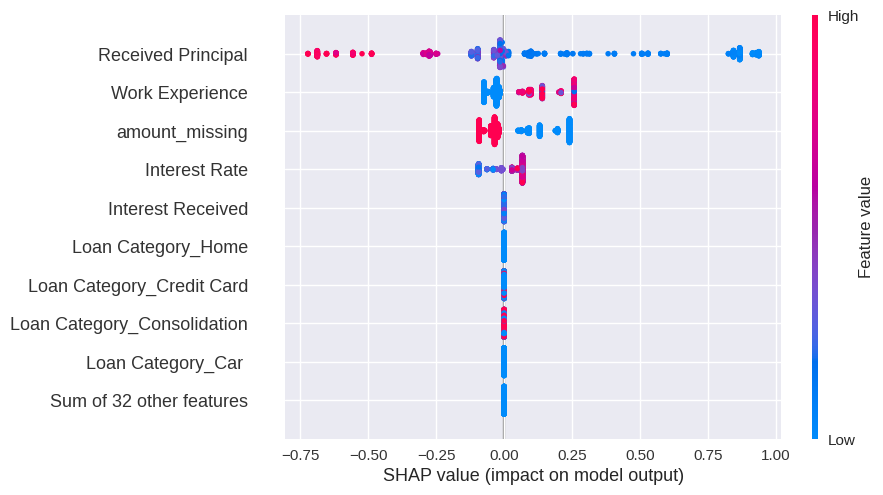

In [100]:
import shap

explainer = shap.TreeExplainer(final_model)

# Calulating the SHAP values for test data

# dmatrix_test = xgb.Dmatrix(test_x, enable_categorical=True)

shap_values = explainer(test_x_FN)

# Summarizing the effects of all the features
shap.plots.beeswarm(shap_values)

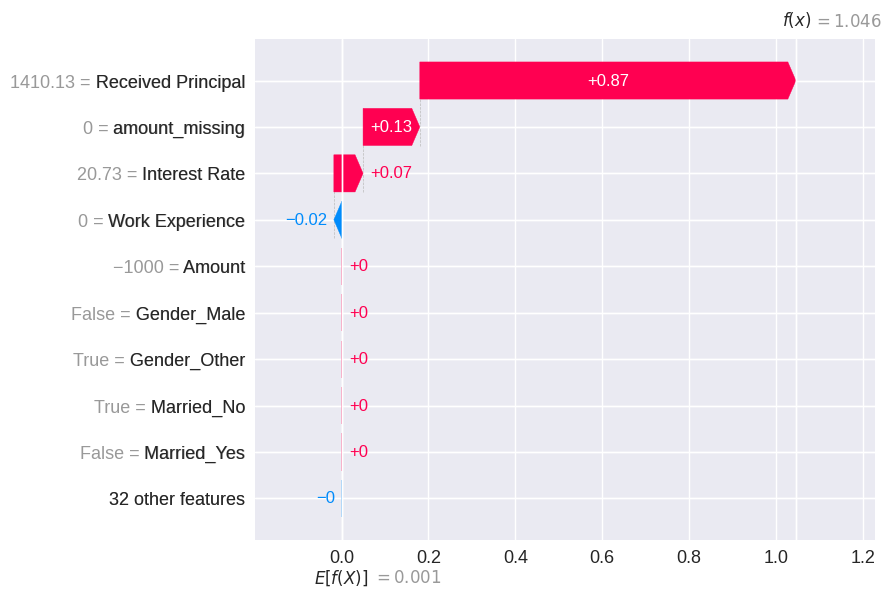

In [102]:
# Visualizing the 1st prediction's explanation

shap.plots.waterfall(shap_values[1])

* **Modeling**

**Formulas**

* **Accuracy = (TP + TN) / (TP + TN + FP + FN)**
* Precision = TP / (TP + FP)
* Recall = TP / (TP + FN)
* F1 Score = 2 * (Precision * Recall) / (Precision + Recall)


* **Using the above formula :**
   *  **Recall for Non-Default (0) = 21453 / (21453 + 4484) = 0.83**
   *  **Recall for Default (1) = 19535 / (19535 + 6630) = 0.75**


* 1. The cost of giving a loan to potential defaulters is 50,000 * 6630 = 331.5 million. This cost represents the potential loss occured when loans are granted to individuals who are likely to default.

* 2. The cost of not giving the loan to non-defaulters is 10,000 * 4484 = 44.84 million. This cost represents missed business opportunities and potential revenue when loans are denied to individuals who would not default.

* 3. Considering the higher cost associated with giving loans to potential defaulters, it becomes a priority for data scientists to tune the model to reduce false negatives. This implies that the focus should be on improving both precision and recall for non-defaulters.

* 4. We can tell as a data scientist that we have to reduce FN to increase the precision and recall for non-defaulters.

* 5. Data Scientists may explore various approaches, such as fine-tuning the model, optimizing feature selection, or incorporating additional relevant data sources.

* 6. Ultimately, the goal is to strike a balance between minimizing the risk of default by accurately identifying potential defaulters while avoiding unnecessary loan denials to creditworthy individuals. This strategy can help mitigate losses and ensure responsible lending practices, benefiting both the lending institution and its customers.